In [1]:
%pip install ydata_profiling
import ydata_profiling as yp
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
%matplotlib inline

Note: you may need to restart the kernel to use updated packages.


# Load dataset

In [86]:
df = pd.read_csv('googleplaystore.csv')

In [88]:
yp.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Display basic info

In [90]:
df.head()

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
0,Photo Editor & Candy Camera & Grid & ScrapBook,ART_AND_DESIGN,4.1,159,19M,"10,000+",Free,0,Everyone,Art & Design,"January 7, 2018",1.0.0,4.0.3 and up
1,Coloring book moana,ART_AND_DESIGN,3.9,967,14M,"500,000+",Free,0,Everyone,Art & Design;Pretend Play,"January 15, 2018",2.0.0,4.0.3 and up
2,"U Launcher Lite – FREE Live Cool Themes, Hide ...",ART_AND_DESIGN,4.7,87510,8.7M,"5,000,000+",Free,0,Everyone,Art & Design,"August 1, 2018",1.2.4,4.0.3 and up
3,Sketch - Draw & Paint,ART_AND_DESIGN,4.5,215644,25M,"50,000,000+",Free,0,Teen,Art & Design,"June 8, 2018",Varies with device,4.2 and up
4,Pixel Draw - Number Art Coloring Book,ART_AND_DESIGN,4.3,967,2.8M,"100,000+",Free,0,Everyone,Art & Design;Creativity,"June 20, 2018",1.1,4.4 and up


In [91]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10841 entries, 0 to 10840
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   App             10841 non-null  object 
 1   Category        10841 non-null  object 
 2   Rating          9367 non-null   float64
 3   Reviews         10841 non-null  object 
 4   Size            10841 non-null  object 
 5   Installs        10841 non-null  object 
 6   Type            10840 non-null  object 
 7   Price           10841 non-null  object 
 8   Content Rating  10840 non-null  object 
 9   Genres          10841 non-null  object 
 10  Last Updated    10841 non-null  object 
 11  Current Ver     10833 non-null  object 
 12  Android Ver     10838 non-null  object 
dtypes: float64(1), object(12)
memory usage: 1.1+ MB


# -------------------------------------------
# Data Cleaning and Preprocessing
# -------------------------------------------

## Fix Rating (Ensure valid range: 0 - 5)

In [97]:
df = df[df['Rating'] <= 5]

## Fix Price (Remove '$' and convert to float)

In [100]:
df["Price"] = df["Price"].replace("Everyone", "0")
df["Price"] = df["Price"].str.replace("$", "", regex=False).astype(float)
print(df["Price"].head())
print(df["Price"].dtype)

0    0.0
1    0.0
2    0.0
3    0.0
4    0.0
Name: Price, dtype: float64
float64


C:\Users\anasm\AppData\Local\Temp\ipykernel_30404\198264715.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Price"] = df["Price"].replace("Everyone", "0")
C:\Users\anasm\AppData\Local\Temp\ipykernel_30404\198264715.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Price"] = df["Price"].str.replace("$", "", regex=False).astype(float)


In [127]:
# 1 for Free apps, 0 for Paid apps
df['Is_Free'] = (df['Type'] == 'Free').astype(int)

print("\nValue counts in Is_Free column:")
print(df['Is_Free'].value_counts())
print("\nSample of the data:")
print(df[['App', 'Type', 'Is_Free']].head())


Value counts in Is_Free column:
Is_Free
1    7155
0     553
Name: count, dtype: int64

Sample of the data:
                                                 App  Type  Is_Free
0     Photo Editor & Candy Camera & Grid & ScrapBook  Free        1
1                                Coloring book moana  Free        1
2  U Launcher Lite – FREE Live Cool Themes, Hide ...  Free        1
3                              Sketch - Draw & Paint  Free        1
4              Pixel Draw - Number Art Coloring Book  Free        1


## Fix Size (Convert 'Varies with device' to NaN, convert MB to KB)

In [102]:
def convert_size(size):
    if 'M' in size:
        return float(size.replace('M', '')) * 1024 
    elif 'k' in size:
        return float(size.replace('k', ''))
    return np.nan

df['Size'] = df['Size'].replace('Varies with device', np.nan)
df['Size'] = df['Size'].dropna().apply(convert_size)


C:\Users\anasm\AppData\Local\Temp\ipykernel_30404\2256078623.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Size'] = df['Size'].replace('Varies with device', np.nan)
C:\Users\anasm\AppData\Local\Temp\ipykernel_30404\2256078623.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Size'] = df['Size'].dropna().apply(convert_size)


In [104]:
print(df['Size'].dtype)

float64


## Fix Installs (Remove ',' and '+' then convert to int)

In [107]:
df['Installs'] = df['Installs'].str.replace(",", "").str.replace("+", "").astype(int)
print(df['Installs'].dtype)

int64


C:\Users\anasm\AppData\Local\Temp\ipykernel_30404\2706080009.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Installs'] = df['Installs'].str.replace(",", "").str.replace("+", "").astype(int)


## Fix Android Version

In [110]:
def extract_major_version(version_str):
    try:
        # Remove 'and up' or similar text if present
        version_str = version_str.split(' ')[0]
        
        # Extract the first number from the version string
        version_num = version_str.split('.')[0]
        
        # Convert to float
        return float(version_num)
    except:
        return None

# Apply the transformation
df['Android_Version_Standardized'] = df['Android Ver'].apply(extract_major_version)

# Check for any null values that might have resulted from the conversion
print("Null values:", df['Android_Version_Standardized'].isnull().sum())

# Display unique values to verify the transformation
print("\nUnique standardized versions:")
print(sorted(df['Android_Version_Standardized'].unique()))

# Optional: Drop rows with null values if needed
df = df.dropna(subset=['Android_Version_Standardized'])

Null values: 1321

Unique standardized versions:
[np.float64(2.0), np.float64(3.0), np.float64(4.0), np.float64(nan), np.float64(1.0), np.float64(5.0), np.float64(6.0), np.float64(7.0), np.float64(8.0)]


C:\Users\anasm\AppData\Local\Temp\ipykernel_30404\562398426.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Android_Version_Standardized'] = df['Android Ver'].apply(extract_major_version)


In [112]:
df['Android_Version_Standardized'].isnull().sum()

np.int64(0)

## Handle Missing Values (Fill with median or mode) And Duplicated Values 


In [115]:
df['Size'].fillna(df['Size'].median(), inplace=True)
df['Rating'].fillna(df['Rating'].median(), inplace=True)
df.dropna(inplace=True)

C:\Users\anasm\AppData\Local\Temp\ipykernel_30404\3007557982.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Size'].fillna(df['Size'].median(), inplace=True)
C:\Users\anasm\AppData\Local\Temp\ipykernel_30404\3007557982.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For

In [117]:
print(df.isnull().sum())

App                             0
Category                        0
Rating                          0
Reviews                         0
Size                            0
Installs                        0
Type                            0
Price                           0
Content Rating                  0
Genres                          0
Last Updated                    0
Current Ver                     0
Android Ver                     0
Android_Version_Standardized    0
dtype: int64


In [119]:
df.duplicated().sum()

np.int64(333)

In [121]:
df.drop_duplicates(inplace=True)

In [123]:
df.duplicated().sum()

np.int64(0)

In [60]:
yp.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# -------------------------------------------
# Outlier Detection
# -------------------------------------------

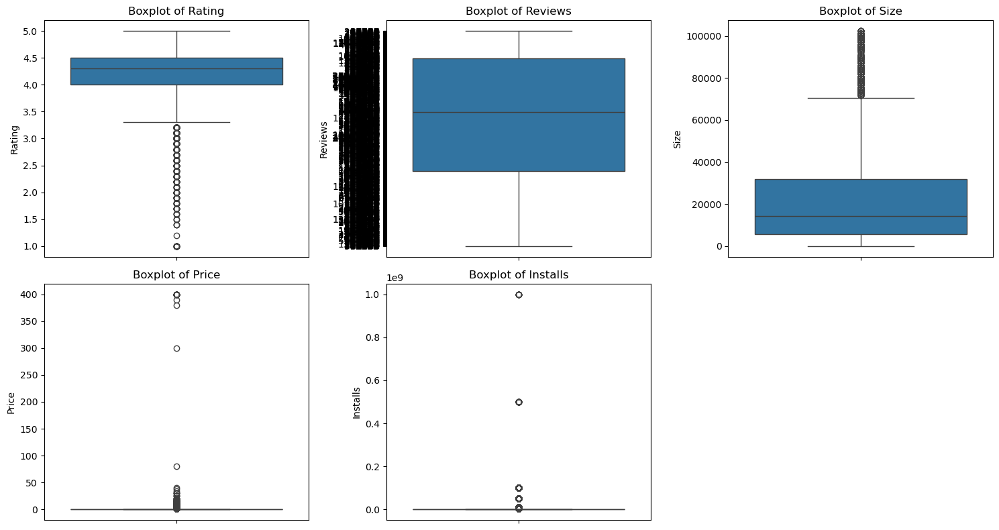

In [129]:
numeric_columns = ['Rating', 'Reviews', 'Size', 'Price', 'Installs']
plt.figure(figsize=(15, 8))
for i, col in enumerate(numeric_columns, 1):
    plt.subplot(2, 3, i)
    sns.boxplot(y=df[col])
    plt.title(f"Boxplot of {col}")
plt.tight_layout()
plt.show()

# -------------------------------------------
# Answering Analytical Questions
# -------------------------------------------

## 1. Most Expensive App

In [135]:
most_expensive_app = df[df['Price'] == df['Price'].max()][['App', 'Price']]
print("Most Expensive App:")
print(most_expensive_app)

Most Expensive App:
                           App  Price
4367  I'm Rich - Trump Edition  400.0


## 2. Genre with the highest number of apps

In [138]:
genre_count = df['Genres'].value_counts().idxmax()
print(f"Genre with the highest number of apps: {genre_count}")

Genre with the highest number of apps: Tools


## 3. Average size of free vs. paid apps

In [171]:
avg_size = df.groupby('Type')['Size'].mean()
print("Average Size of Free vs Paid Apps:")
print(f'{avg_size}')

Average Size of Free vs Paid Apps:
Type
Free    23066.445213
Paid    20985.431826
Name: Size, dtype: float64


## 

## 4. Top 5 most expensive apps with rating 5

In [197]:
expensive_high_rated = df[(df['Rating'] == 5)].nlargest(5, 'Price')
print("Top 5 Most Expensive Apps with Rating 5:")
print(expensive_high_rated[['App', 'Price', 'Rating']])

Top 5 Most Expensive Apps with Rating 5:
                                            App  Price  Rating
5489                  AP Art History Flashcards  29.99     5.0
7477                 USMLE Step 2 CK Flashcards  19.99     5.0
5246                      Hey AJ! It's Bedtime!   4.99     5.0
5482                 meStudying: AP English Lit   4.99     5.0
7204  TI-84 CE Graphing Calculator Manual TI 84   4.99     5.0


## 5. Number of apps with more than 50K reviews

In [199]:
apps_50k_reviews = df[df['Reviews'].astype(float) > 50000].shape[0]
print(f"Number of apps with more than 50K reviews: {apps_50k_reviews}")

Number of apps with more than 50K reviews: 1807


## 6. Average price grouped by genre and installs

In [201]:
avg_price_grouped = df.groupby(['Genres', 'Installs'])['Price'].mean()
print("Average Price Grouped by Genre & Installs:")
print(avg_price_grouped)


Average Price Grouped by Genre & Installs:
Genres  Installs
Action  10          0.000000
        50          1.990000
        100         1.370000
        1000        0.425714
        5000        0.000000
                      ...   
Word    100000      0.000000
        1000000     0.000000
        5000000     0.000000
        10000000    0.000000
        50000000    0.000000
Name: Price, Length: 790, dtype: float64


## 7. Number of apps with rating > 4.7 and their avg price

In [203]:
high_rated_apps = df[df['Rating'] > 4.7]
print(f"Number of apps with rating > 4.7: {high_rated_apps.shape[0]}")
print(f"Average price: {high_rated_apps['Price'].mean()}")

Number of apps with rating > 4.7: 569
Average price: 0.43966608084358527


## 8. Estimated Google Revenue from apps with 5M+ installs


In [205]:
google_revenue = df[df['Installs'] >= 5000000]['Price'].sum() * 0.30
print(f"Estimated Google Revenue from apps with 5M+ installs: ${google_revenue:.2f}")

Estimated Google Revenue from apps with 5M+ installs: $0.30


## 9. Max & Min sizes of free vs paid apps


In [207]:
size_stats = df.groupby('Type')['Size'].agg(['max', 'min'])
print("Max & Min Sizes of Free vs Paid Apps:")
print(size_stats)

Max & Min Sizes of Free vs Paid Apps:
           max   min
Type                
Free  102400.0   8.5
Paid  102400.0  17.0


## 10. Correlation Matrix


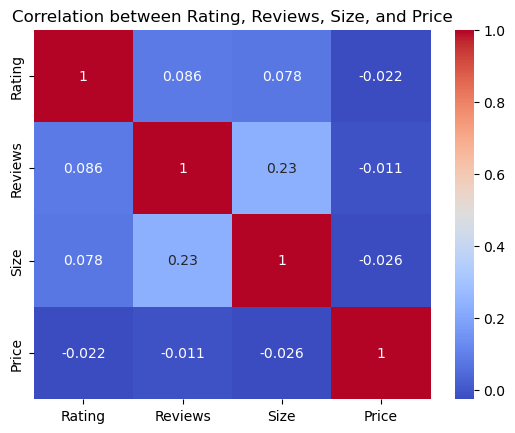

In [209]:
correlation_matrix = df[['Rating', 'Reviews', 'Size', 'Price']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title("Correlation between Rating, Reviews, Size, and Price")
plt.show()


## 11. Number of free/paid apps by content rating


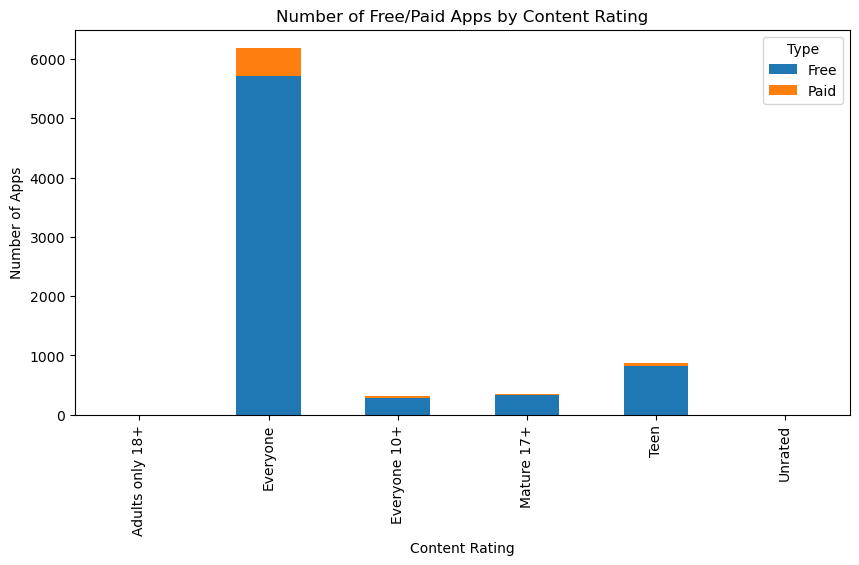

In [211]:
content_rating_count = df.groupby(['Content Rating', 'Type']).size().unstack()
content_rating_count.plot(kind='bar', stacked=True, figsize=(10, 5))
plt.title("Number of Free/Paid Apps by Content Rating")
plt.xlabel("Content Rating")
plt.ylabel("Number of Apps")
plt.legend(title='Type')
plt.show()

## 12. Number of apps compatible with Android 4.x


In [213]:
android_4x_apps = df[df['Android Ver'].str.startswith('4.')]
print(f"Number of apps compatible with Android 4.x: {android_4x_apps.shape[0]}")

Number of apps compatible with Android 4.x: 5602


# ("Data cleaning and analysis completed successfully!")